# What's Covered?

- What can be done with the Data class including:
    - Quick plotting
    - Preprocessing (filtering etc)
    - Subtraction/Addition
    - Slicing
    - Saving
- How to subclass data and why

# Standard Set-up of Examples
The standard set-up for these examples, you would not normally do this in every individual .ipynb file

In [1]:
import dat_analysis


def get_dat(datnum, raw=False, overwrite=False):
    """
    Define a simple get_dat function that knows where to load dats from and save them to

    Note: In a full setup where a path to `measurement-data` and a general save location have already been set in the dat_analysis config.toml, you can use:
        return dat_analysis.get_dat(datnum, host_name, user_name, experiment_name, raw=raw, overwrite=overwrite)
    """
    hdf_name = f"dat{datnum}{'_RAW' if raw else ''}.h5"
    return dat_analysis.get_dat_from_exp_filepath(
        f"experiment_dats/{hdf_name}",
        override_save_path=f"analyzed_dats/{hdf_name}",
        overwrite=overwrite,
    )

In [2]:
dat = get_dat(6420)
dat

Dat6420 - March 3, 2023 14:35:42

# Getting Data

This is common enough that there is a shortcut to it directly in `dat_analysis`, although it is defined in `dat_analysis.analysis_tools.data`

In [3]:
from dat_analysis import Data
import numpy as np

data = Data(x=np.linspace(0, 10), data=np.sin(np.linspace(0, 10)))
print(type(data))

<class 'dat_analysis.analysis_tools.data.Data'>


To get a very quick look at what the `data` contains, just leave it at the end of a cell

In [4]:
data

The `Data` object is basically a holder for `x`, `y`, `data`, `xerr`, `yerr`, `plot_info` which are things that are often nice to keep together

Let's demonstrate that a little here

In [5]:
data.plot_info.x_label = 'My x label'
data.plot_info.y_label = 'My y label'
data.plot_info.title = 'My Title'
fig = data.plot()
fig

But, it is **MUCH** more powerful than that... Let's use some real data to demonstrate

# Examples with real data

Let's load a 2D dataset and use that for demonstrating the power of the `Data` class

In [6]:
data = dat.get_Data('cscurrent_2d')  # this could be any data saved in the dat (dat.Data.data_keys to see what is there)
data

Immediately, we can see data that we want to work with, and we can modify this easily.

In [7]:
# data.power_spectrum(...)  

In [8]:
data.notch_filter([60, 180], Q=10, measure_freq=dat.Logs.measure_freq)

And we can chain these sorts of things together

In [9]:
new_data = data.notch_filter([60, 180], Q=10, measure_freq=dat.Logs.measure_freq).decimate(numpnts=200).diff(axis=-1)
new_data

Any time you do a modification like this, you are returned a new copy of the data.

That means you can easily compare before and after, and you don't have to worry about modifying data in other places accidentally.

In [10]:
from dat_analysis.plotting.plotly.util import figures_to_subplots
figures_to_subplots([data.plot(), new_data.plot()], title='Before and After')

Also, a title is automatically created that let's you know what processing you have done (good for quickly putting plots in a notebook).

# Specific Examples

In [11]:
data = dat.get_Data('cscurrent_2d')  # this could be any data saved in the dat (dat.Data.data_keys to see what is there)

## .plot
As it sounds, makes a figure from the data

**Note: set `resample=False` to get the full density of datapoints, otherwise downsamples before plotting to prevent clogging the notebook**

In [12]:
fig = data.plot(resample=True)  
type(fig)

plotly.graph_objs._figure.Figure

## .get_traces
Returns just the traces that would be added to a figure (useful when plotting many 1D data into a single figure for example)

In [13]:
twod_traces = data.get_traces(max_num_pnts=1000, name='data2d')
print(type(twod_traces[0]))

oned_traces = data.mean().get_traces(name='data1d')
print(type(oned_traces[0]))

<class 'plotly.graph_objs._heatmap.Heatmap'>
<class 'plotly.graph_objs._scatter.Scatter'>


## .power_spectrum
Calculates the power spectrum of the data and returns an instance of PowerSpectrumData (which is a subclass of Data that plots slightly differently)

In [19]:
measure_frequency = dat.Logs.scan_vars['measureFreq']
power_spec = data.mean().power_spectrum(measure_frequency, density=True, logx=False, logy=True)
power_spec

## .center
Centers data given a list of center values

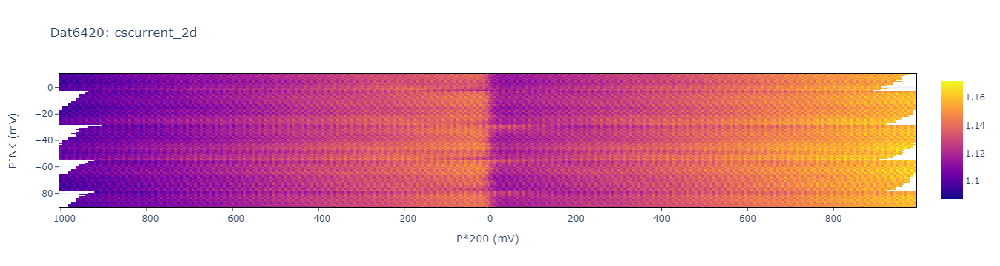

In [15]:
# Getting some example centers by finding the minimums of differentiated data
diffd = data.decimate(numpnts=200).diff()
centers = diffd.x[np.nanargmin(diffd.data, axis=1)]

# Now centering with those centers
centered_data = data.center(centers=centers)
centered_data

## .mean
Averages data in given axis (optionally after centering with provided centers)

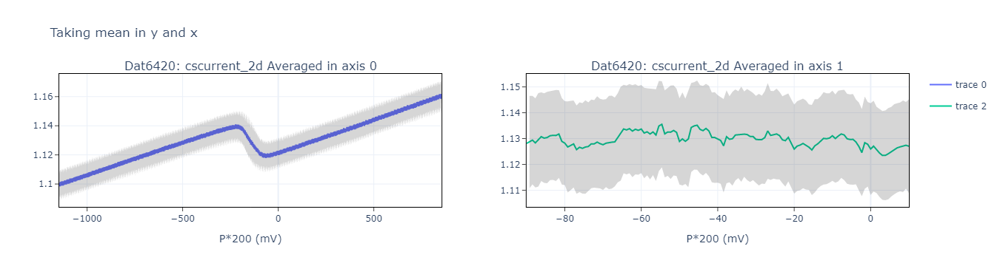

In [16]:
figures_to_subplots([data.mean(axis=0).plot(), data.mean(axis=1).plot()], title='Taking mean in y and x')

## .diff
Differentiates data in given axis

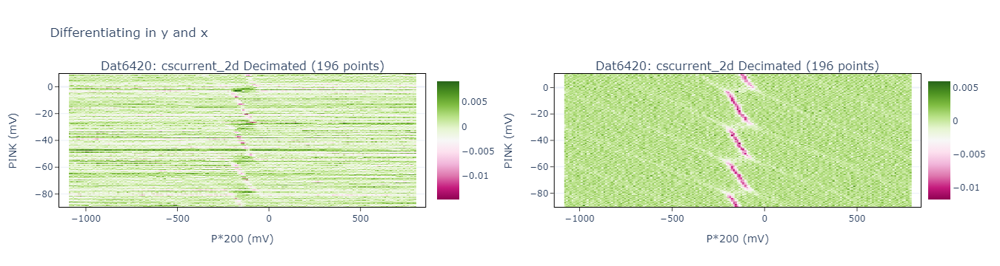

In [17]:
decimated = data.decimate(numpnts=200)
figures_to_subplots([decimated.diff(axis=0).plot(), decimated.diff(axis=1).plot()], title='Differentiating in y and x')

## .smooth
Smooths data in given axis using `scipy.signal.savgol_filter` (does not downsample)

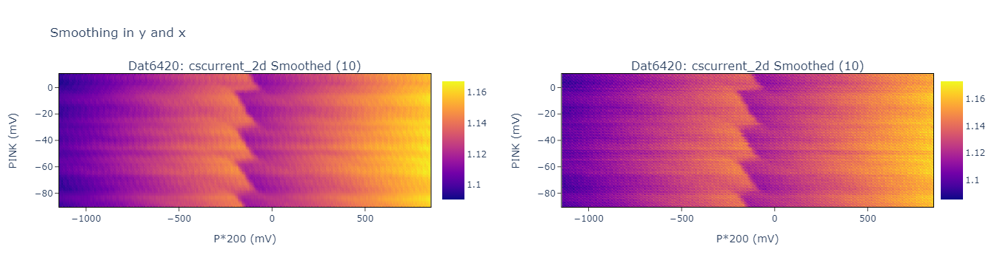

In [18]:
figures_to_subplots([data.smooth(axis=0, window_length=10).plot(), data.smooth(axis=1, window_length=10).plot()], title='Smoothing in y and x')

## .decimate
Low pass filters then downsamples data leaving `np.nan` in the edges where the lowpass filter creates artifacts. 

Note: the lowpass filter is a zero-phase filter

This can be done either by specifying how many datapoints you'd like to end up with, or by specifying the low pass frequency you'd like to decimate to (as long as you know the measurement frequency)

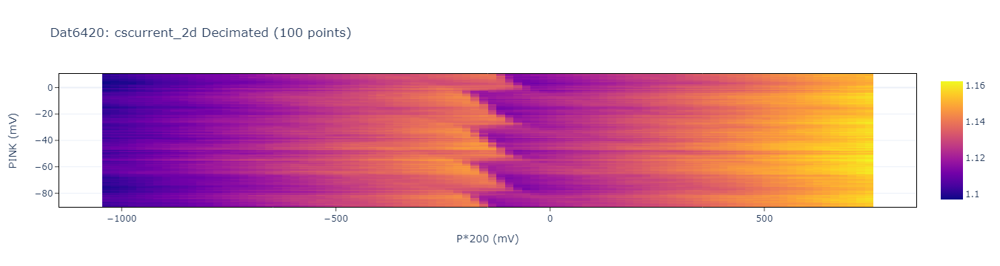

In [19]:
# Decimating by frequency (Just putting this here as an example)
decimated_to_100hz = data.decimate(measure_freq=dat.Logs.measure_freq, desired_freq=100)

# Decimating to target no. points
decimated = data.decimate(numpnts=100)
decimated

## .notch_filter
Notch filters given frequencies with Q factors

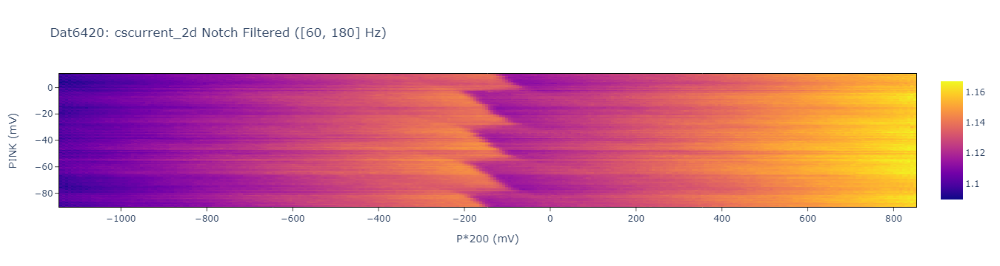

In [20]:
# Notch filter 60 and 180Hz with Q factors of 10 and 5 respectively
notch_filtered = data.notch_filter(notch_freq=[60, 180], Q=[10,5], measure_freq=dat.Logs.measure_freq)
notch_filtered

## .bin
Bins data (i.e. basic downsampling with averaging)

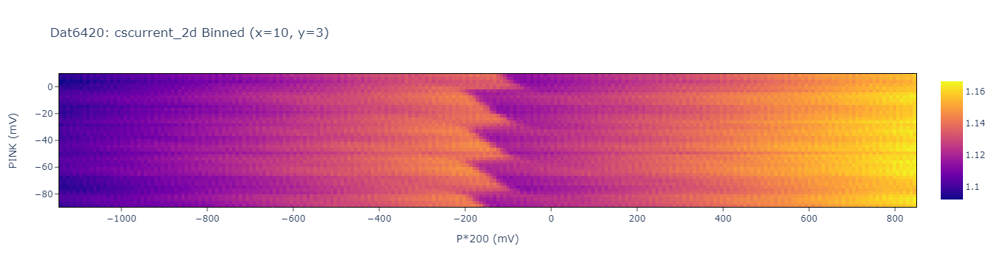

In [21]:
binned = data.bin(bin_x=10, bin_y=3)
binned

## subtract
You can subtract one instance of Data from another, and the x and y axes will be respected 
Note: the resulting Data will only include the overlap between them

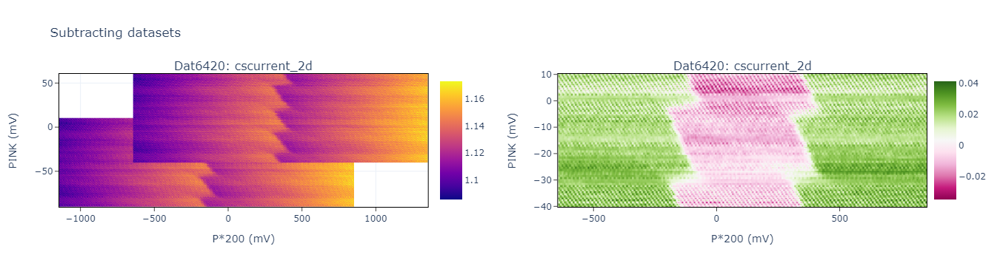

In [22]:
# Make a copy of data and offset it as an example for subtracting/adding
offset = data.copy()
offset.x += 500
offset.y += 50

fig_before = data.plot()
fig_before.add_traces(offset.get_traces())

subtracted = data-offset
fig_after = subtracted.plot()

figures_to_subplots([fig_before, fig_after], title=f'Subtracting datasets')

## add
Same as subtracting, but addition...

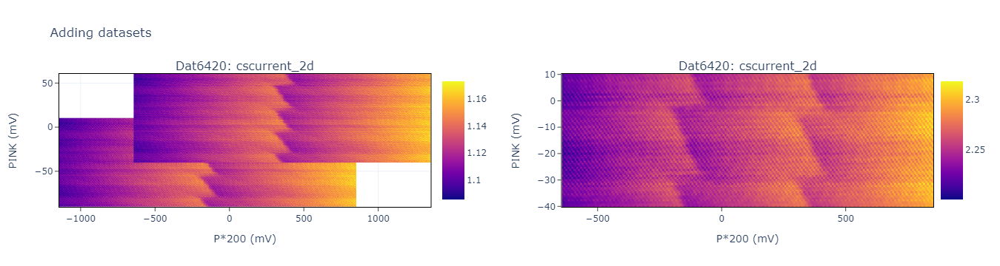

In [23]:
# Using same offset data as for subtract
added = data+offset
fig_after = added.plot()

figures_to_subplots([fig_before, fig_after], title=f'Adding datasets')

## slicing
Allows slicing of Data similar to how you can slice numpy arrays, but also applies the slicing the x and y axes where necessary

Note: This is slicing by index value, not the x/y axes values

After slicing: x.shape = (10,), data.shape = (10,), xerr.shape = (10,), yerr.shape = (10,)


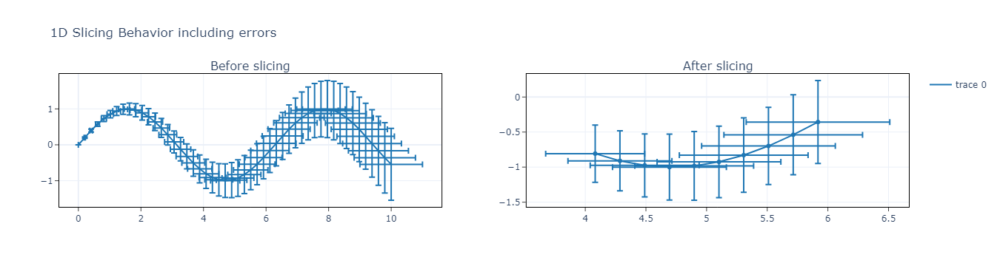

In [24]:
d_1d = Data(
    x=np.linspace(0, 10, 50),
    data=np.sin(np.linspace(0, 10, 50)),
    xerr=np.linspace(0, 1, 50),
    yerr=np.linspace(0, 1, 50),
)
sliced_1d = d_1d[20:30]
print(f"After slicing: x.shape = {sliced_1d.x.shape}, data.shape = {sliced_1d.data.shape}, xerr.shape = {sliced_1d.xerr.shape}, yerr.shape = {sliced_1d.yerr.shape}")
figures_to_subplots(
    [
        d_1d.plot().update_layout(title="Before slicing"),
        sliced_1d.plot().update_layout(title="After slicing"),
    ],
    title="1D Slicing Behavior including errors",
    shared_data=True,
)

After slicing: x.shape = (10,), data.shape = (10, 10), yerr.shape = (10, 10)


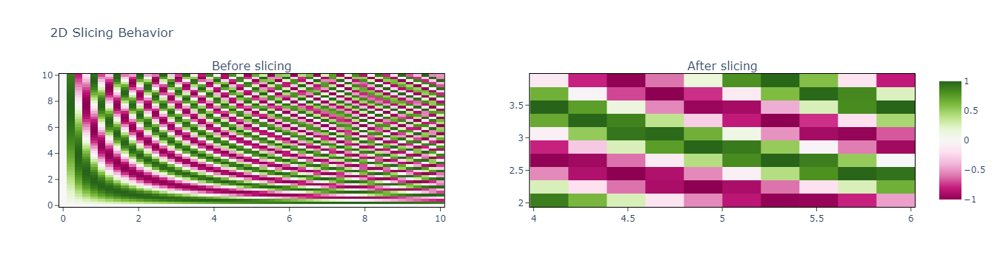

In [25]:
d_2d = Data(
    x=np.linspace(0, 10, 50),
    y=np.linspace(0, 10, 50),
    data=None,
    yerr=np.ones((50, 50)),  # yerr assumed to be data_err for 2D
)
d_2d.data = np.sin(d_2d.x * d_2d.y[:, None])
sliced_2d = d_2d[10:20, 20:30]
print(f"After slicing: x.shape = {sliced_2d.x.shape}, data.shape = {sliced_2d.data.shape}, yerr.shape = {sliced_2d.yerr.shape}")
figures_to_subplots(
    [
        d_2d.plot().update_layout(title="Before slicing"),
        sliced_2d.plot().update_layout(title="After slicing"),
    ],
    title="2D Slicing Behavior",
    shared_data=True,
)

Data shape before slicing: (131, 5076)
Data shape after slicing: (45, 1000)


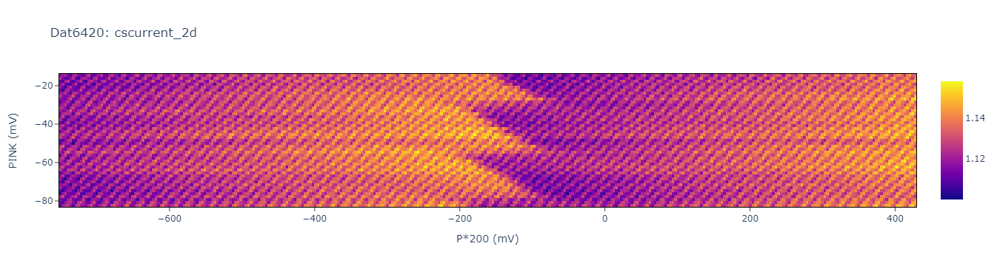

In [26]:
print(f"Data shape before slicing: {data.data.shape}")
# Slicing from 10th to 100th index in steps of 2 in y, and corresponding values for x
sliced = data[10:100:2, 1000:4000:3]
print(f"Data shape after slicing: {sliced.data.shape}")
sliced

## .slice_values
Allows slicing of Data based on x and y axes rather than indexes

Data shape before slicing: (131, 5076)
Data shape after slicing: (66, 2285)


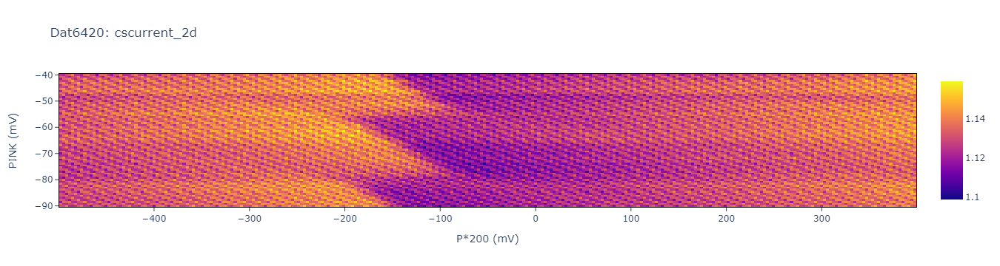

In [27]:
print(f'Data shape before slicing: {data.data.shape}')
# Note: use `None` to mean from beginning or end depending on position
sliced = data.slice_values(x_range=[-500, 400], y_range=[None, -40])
print(f'Data shape after slicing: {sliced.data.shape}')
sliced

## .save_to_txt
Saves to `.txt` file using `np.savetxt`

In [28]:
# Let's save to here to keep the example folder tidy
save_dir = 'analyzed_dats/'

data.save_to_txt(filepath=save_dir+'example_txt.txt', overwrite=True)

Note that multiple `.txt` files are saved, one for each of `x`, `y`, `data`, `xerr`, `yerr` 

## .save_to_mat
Saves to `.mat` file

In [29]:
data.save_to_mat(filepath=save_dir+'example_mat.mat', overwrite=True)

For `.mat` files, each of the `x`, `y`, `data`, `xerr`, `yerr` parts are saved in a single `.mat` 

## .save_to_itx
Saves to `.itx` including the x and y axes, and even the x and y axis labels if present in the `Data.plot_info`

In [30]:
data.save_to_itx(filepath=save_dir+'example_itx.itx', overwrite=True)

For `.itx` files, the `x`, `y`, `data` are saved to a single igor `wave` along with the `x_label` and `y_label` of the `data.plot_info`.

Note: if the `x` or `y` axes are not linear, they will be saved separately as Igor does not support non-linear axes.